$\Large\color{blue}{\text{PyGMTSAR Small Baseline Subset (SBAS) Interferometric InSAR}}$

$\Large\color{blue}{\text{On GMTSAR dataset S1A_Stack_CPGF_T173}}$

$\large\color{blue}{\text{Ehnanced SBAS processing excludes atmosperic noise and validates results}}$

### See and more PyGMTSAR notebooks on GitHub: [PyGMTSAR](https://github.com/mobigroup/gmtsar)

* MacOS Monterey (Apple Silicon) and BigSur (Intel) (Python 3.10) -  follow PyGMTSAR documentation to install all the dependencies,

* Google Cloud VM and Notebooks on Debian 10 (Python 3.7) and Ubuntu 18.04, 20.04, 22.04 (Python 3.7, 3.8, 3.9, 3.10) -  follow PyGMTSAR documentation to install all the dependencies,

* Google Colab (Python 3.7) - all the requirements will be installed by the commands below.

### PyGMTSAR is my free-time Open Source project.

That's a bit curious how the project was started a year ago. I develop geophysical inversion methods and processing software for many years using my fundamental physics and mathematics background. Satellite interferometry is the key point to validate my inversion models and I found the same problem as you too that the existing interferometry packages usage is a pain. There is no interactive processing with multiprocessing and even a progressbar and ability to view and change every step code and validate the results. Also, many used algorithms are too outdated and produce terrible results like to tension surfaces in GMT which is used widely in GMTSAR (hmm, how about to control a smothness of derivative? Tension surfaces were invented when all the Earths computers where less powerfull than your smarthone today. If you are interested I shared the examples in GMTSAR bug tracker). Anyway, I found GMT mathematics is really crazy and the developers replace one incorrect algorithm by another and back often as we see in the codes and the changelog). That was enough reason to check all the used algorithms and replace these by modern and correct ones. By this way, I use only GMTSAR C codes with my patches to fix some errors and allow interoperability with Python wrappers plus my own codes around them. GMTSAR codes are fine and without crazy GMT codes work better and the processing is much faster. Alright, I spent one month to make the initial PyGMTSAR realization and it works. Recently, I returned to the project to add some more sophisticated features like to scenes and subswathes stitching. I'm going to share some of my geological exprorations and seismic models as live examples on Google Colab as soon as it will be possible to do. How lineaments and ore zones are related to interferograms? How gas and oil deposits are related to surface movements on interferometry displacement maps? I have the answer and I work on the tools to model and visualize them.

You'd find my theoretical models and processing codes foir geophisical inversions in Github repository https://github.com/mobigroup/gis-snippets and tools for the 4D results vizualization in https://github.com/mobigroup/ParaView-plugins

Ah yes, a little bit about me. I have STEM master's degree in radio physics and in 2004 I was awarded first prize of the All-Russian Physics competition for significant results in Inverse modeling for non-linear optics and holography, also applicable for Inverse Modeling of Gravity, Magnetic, and Thermal fields. In addition to my fundamental science knowledge, I’m world class data scientist and software developer with 20 years experience in science and industrial development. I have worked on government contracts and universities projects and on projects for LG Corp, Google Inc, etc. You are able to find some of my software and results on LinkedIn and GitHub and Upwork. By the way, I left Russia many years ago and I work remotely for about 20 years.

### To order some research, development and support see my profile on freelance platform [Upwork](https://www.upwork.com/freelancers/~01e65e8e7221758623)

### @ Alexey Pechnikov, August, 2022

[Geological models on YouTube channel](https://www.youtube.com/channel/UCSEeXKAn9f_bDiTjT6l87Lg)

[Augmented Reality (AR) Geological Models](https://mobigroup.github.io/ParaView-Blender-AR/)

[GitHub repositories](https://github.com/mobigroup)

[English posts and articles on LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/)

[Russian articles on Habr](https://habr.com/ru/users/N-Cube/posts/)

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Load Modules to Check Environment

In [1]:
import platform, sys, os

## Google Colab Installation

### Install GMTSAR
https://github.com/gmtsar/gmtsar

In [2]:
if 'google.colab' in sys.modules:
    count = !ls /usr/local | grep GMTSAR | wc -l
    if count == ['0']:
        !apt install -y csh autoconf gfortran \
            libtiff5-dev libhdf5-dev liblapack-dev libgmt-dev gmt-dcw gmt-gshhg gmt > /dev/null
        !cd /usr/local && git clone --branch master https://github.com/gmtsar/gmtsar GMTSAR > /dev/null
        !cd /usr/local/GMTSAR && autoconf > /dev/null
        !cd /usr/local/GMTSAR && ./configure --with-orbits-dir=/tmp > /dev/null
        !cd /usr/local/GMTSAR && make 1>/dev/null 2>/dev/null
        !cd /usr/local/GMTSAR && make install >/dev/null



Cloning into 'GMTSAR'...
remote: Enumerating objects: 5836, done.
remote: Counting objects: 100% (302/302), done.
remote: Compressing objects: 100% (127/127), done.
remote: Total 5836 (delta 187), reused 280 (delta 171), pack-reused 5534
Receiving objects: 100% (5836/5836), 18.07 MiB | 32.68 MiB/s, done.
Resolving deltas: 100% (3968/3968), done.


### Define ENV Variables for Jupyter Instance

In [3]:
# use default GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

env: PATH=/opt/bin:/usr/local/nvidia/bin:/usr/local/cuda/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/tools/node/bin:/tools/google-cloud-sdk/bin:/usr/local/GMTSAR/bin/


### Install Python Modules

Maybe you need to restart your notebook, follow the instructions printing below.

The installation takes a long time on fresh Debian 10 and a short time on Google Colab

In [4]:
!{sys.executable} --version

Python 3.7.14


In [5]:
if 'google.colab' in sys.modules:
    !{sys.executable} -m pip install \
        h5py netcdf4 h5netcdf \
        rasterio rioxarray numpy \
        scikit-image scipy sklearn \
        xarray dask distributed zarr nc-time-axis \
        pandas geopandas \
        sentineleof elevation \
        matplotlib seaborn geoviews hvplot datashader bokeh \
        xmltodict joblib tqdm 1>/dev/null 2>/dev/null

In [6]:
!{sys.executable} -m pip install pygmtsar --upgrade
# fix for Python 3.7 actually
if 'google.colab' in sys.modules:
    !{sys.executable} -m pip install importlib_metadata==4.12.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 57 kB 4.1 MB/s 
     |████████████████████████████████| 82 kB 866 kB/s 
     |████████████████████████████████| 86 kB 4.5 MB/s 
     |████████████████████████████████| 1.6 MB 28.7 MB/s 
  Created wheel for dask-image: filename=dask_image-2022.9.0-py2.py3-none-any.whl size=41054 sha256=e487b0cd5327650c2cc25b2b64c35b5adae02edfa2c8fdb999657a23d2a36cbe
  Stored in directory: /root/.cache/pip/wheels/df/c8/2e/959a7f977f3bebaf73889bb6422cfb4075bdd2501ed521a4a8
  Created wheel for pims: filename=PIMS-0.6.1-py3-none-any.whl size=82636 sha256=b9e06b70f0ead03cdc7c92e9aff6c313a2f9037243299e589666613f87dfc91f
  Stored in directory: /root/.cache/pip/wheels/8e/d5/a9/f702433436655b7a2bc7ff93efd742587dd5abd44f7e406917
Successfully built dask-image pims
  Attempting uninstall: importlib-metadata
    Found existing installation: importlib-metadata 5.0.0
    Uninstalli

## Load and Setup Python Modules

In [7]:
import xarray as xr
import numpy as np
import pandas as pd
# supress numpy warnings
import warnings
warnings.filterwarnings('ignore')

In [8]:
# plotting modules
import hvplot.pandas  # noqa
import hvplot.xarray  # noqa
import holoviews as hv
pd.options.plotting.backend = 'hvplot'
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [9]:
# show interactive plots if allowed
# attention: the plots require a lot of RAM and produce segfaults on some environments
USE_INTERACTIVE_PLOTS = False
if USE_INTERACTIVE_PLOTS:
    gstiles = hv.Tiles('https://mt1.google.com/vt/lyrs=s&x={X}&y={Y}&z={Z}', name='Google Satellite')
    ottiles = hv.Tiles('https://tile.opentopomap.org/{Z}/{X}/{Y}.png', name='Open Topo')

In [10]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

In [11]:
from pygmtsar import SBAS

## Download and unpack example dataset

In [12]:
!wget -c http://topex.ucsd.edu/gmtsar/tar/S1A_Stack_CPGF_T173.tar.gz
!rm -rf raw_orig topo
!tar xvzf S1A_Stack_CPGF_T173.tar.gz -C .

--2022-10-08 08:32:42--  http://topex.ucsd.edu/gmtsar/tar/S1A_Stack_CPGF_T173.tar.gz
Resolving topex.ucsd.edu (topex.ucsd.edu)... 132.239.154.64
Connecting to topex.ucsd.edu (topex.ucsd.edu)|132.239.154.64|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://topex.ucsd.edu/gmtsar/tar/S1A_Stack_CPGF_T173.tar.gz [following]
--2022-10-08 08:32:43--  https://topex.ucsd.edu/gmtsar/tar/S1A_Stack_CPGF_T173.tar.gz
Connecting to topex.ucsd.edu (topex.ucsd.edu)|132.239.154.64|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1662140448 (1.5G) [application/x-gzip]
Saving to: ‘S1A_Stack_CPGF_T173.tar.gz’

S1A_Stack_CPGF_T173 100%[===================>]   1.55G  10.1MB/s    in 75s     

2022-10-08 08:33:59 (21.1 MB/s) - ‘S1A_Stack_CPGF_T173.tar.gz’ saved [1662140448/1662140448]

./
./README_sbas.txt
./.DS_Store
./topo/
./raw_orig/
./README_prep.txt
./batch_tops.config
./._.
./README_proc.txt
./raw_orig/20150521_manifest.safe
./raw_

## Define Parameters

In [13]:
MASTER       = '2015-04-03'
WORKDIR      = 'raw_stack'
DATADIR      = 'raw_orig'
DEMFILE      = 'topo/dem.grd'
BASEDAYS     = 100
BASEMETERS   = 150
DEFOMAX      = 0

## Init SBAS

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

In [14]:
# use DEM from the example
sbas = SBAS(DATADIR, DEMFILE, WORKDIR).set_master(MASTER)
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2015-01-21,2015-01-21 13:44:13,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150121t134413-20150121t134424-004270-005317-001.tiff,raw_orig/s1a-iw1-slc-vv-20150121t134413-20150121t134424-004270-005317-001.xml,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150211T122339_V20150120T225944_20150122T005944.EOF,"POLYGON ((-114.64120 32.61750, -115.63261 32.77573, -115.74567 32.06737, -114.75426 31.90914, -114.64120 32.61750))"
2015-03-10,2015-03-10 13:44:12,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150310t134412-20150310t134424-004970-006386-001.tiff,raw_orig/s1a-iw1-slc-vv-20150310t134412-20150310t134424-004970-006386-001.xml,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150331T123006_V20150309T225944_20150311T005944.EOF,"POLYGON ((-114.64089 32.61808, -115.63217 32.77630, -115.74528 32.06769, -114.75400 31.90946, -114.64089 32.61808))"
2015-04-03,2015-04-03 13:44:13,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150403t134413-20150403t134424-005320-006bc4-001.tiff,raw_orig/s1a-iw1-slc-vv-20150403t134413-20150403t134424-005320-006bc4-001.xml,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150424T123026_V20150402T225944_20150404T005944.EOF,"POLYGON ((-114.64322 32.60958, -115.63290 32.76751, -115.74326 32.07591, -114.75358 31.91797, -114.64322 32.60958))"
2015-04-27,2015-04-27 13:44:14,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150427t134414-20150427t134426-005670-00745c-001.tiff,raw_orig/s1a-iw1-slc-vv-20150427t134414-20150427t134426-005670-00745c-001.xml,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150518T122528_V20150426T225944_20150428T005944.EOF,"POLYGON ((-114.64307 32.60829, -115.63270 32.76624, -115.74309 32.07464, -114.75346 31.91668, -114.64307 32.60829))"
2015-05-21,2015-05-21 13:44:15,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150521t134415-20150521t134427-006020-007c3f-001.tiff,raw_orig/s1a-iw1-slc-vv-20150521t134415-20150521t134427-006020-007c3f-001.xml,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150611T122710_V20150520T225944_20150522T005944.EOF,"POLYGON ((-114.64223 32.60828, -115.63194 32.76625, -115.74233 32.07465, -114.75262 31.91668, -114.64223 32.60828))"


### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [15]:
plots = None
if USE_INTERACTIVE_PLOTS:
    opts_common = {'x':'lon', 'y':'lat', 'geo':True, 'width':800, 'height':400}
    opts1 = {'tiles':gstiles, 'alpha':0.2, 'title': 'Sentinel1 Scenes Approximate Location'}
    plots = sbas.to_dataframe().reset_index().hvplot(color='date', **{**opts_common, **opts1})
plots

### Static Plots

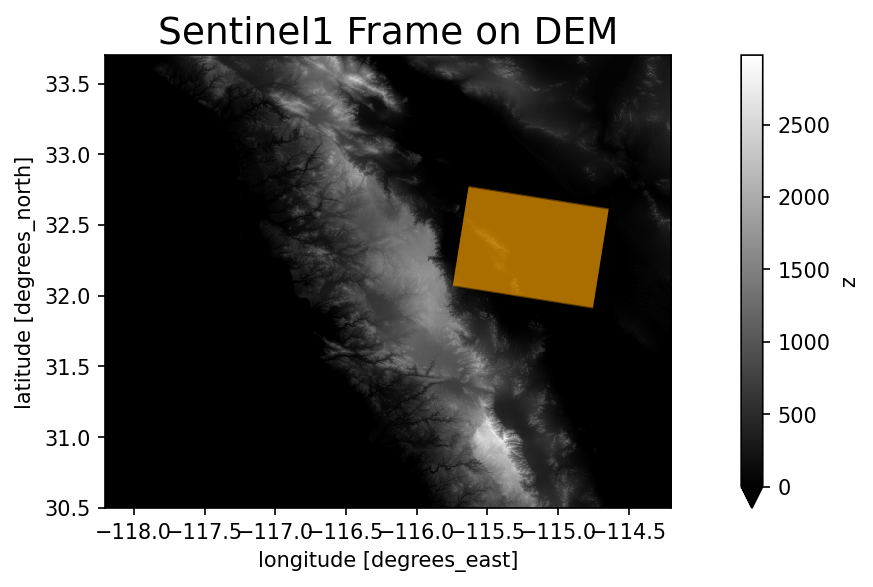

In [16]:
plt.figure(figsize=(12,4), dpi=150)
dem = sbas.get_dem()
dem[::4,::4].plot.imshow(cmap='gray', vmin=0)
sbas.to_dataframe().plot(color='orange', alpha=0.2, ax=plt.gca())
plt.title('Sentinel1 Frame on DEM', fontsize=18)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [17]:
plots = None
if USE_INTERACTIVE_PLOTS:
    title = 'Subswath Topo'
    opts_common = {'x':'lon', 'y':'lat', 'geo':True, 'width':800, 'height':400}
    plots = sbas.get_dem()[::4,::4].hvplot(cmap='gray', alpha=1, title=title, **opts_common) \
        * sbas.to_dataframe().reset_index().hvplot(color='date', alpha=0.2, **opts_common)
plots

## Align a Stack of Images

In [18]:
sbas.stack_parallel()

Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning:   0%|          | 0/4 [00:00<?, ?it/s]

## SBAS Baseline

In [19]:
baseline_pairs = sbas.baseline_pairs(days=BASEDAYS, meters=BASEMETERS)
baseline_pairs

,ref_date,rep_date,ref_timeline,ref_baseline,rep_timeline,rep_baseline
0,2015-01-21,2015-03-10,2015.05,52.61,2015.19,-37.72
1,2015-01-21,2015-04-03,2015.05,52.61,2015.25,-0.00
2,2015-01-21,2015-04-27,2015.05,52.61,2015.32,-30.42
3,2015-03-10,2015-04-03,2015.19,-37.72,2015.25,-0.00
4,2015-03-10,2015-04-27,2015.19,-37.72,2015.32,-30.42
5,2015-03-10,2015-05-21,2015.19,-37.72,2015.38,-50.97
6,2015-04-03,2015-04-27,2015.25,-0.00,2015.32,-30.42
7,2015-04-03,2015-05-21,2015.25,-0.00,2015.38,-50.97
8,2015-04-27,2015-05-21,2015.32,-30.42,2015.38,-50.97


### Static Plot

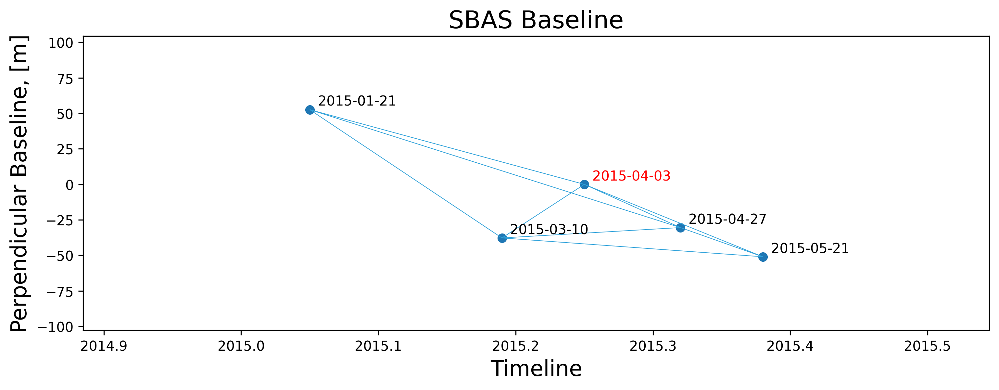

In [20]:
plt.figure(figsize=(12,4), dpi=300)
ax = plt.gca()

lines = [[(row.ref_timeline,row.ref_baseline),(row.rep_timeline,row.rep_baseline)]
         for row in baseline_pairs.itertuples()]
lc = matplotlib.collections.LineCollection(lines, colors='#30a2da', linewidths=0.5)
ax.add_collection(lc)
ax.autoscale()
ax.margins(0.5)
bs1 = baseline_pairs[['ref_timeline','ref_baseline','ref_date']].values
bs2 = baseline_pairs[['rep_timeline','rep_baseline','rep_date']].values
df = pd.DataFrame(np.concatenate([bs1, bs2]), columns=['timeline','baseline','date']).drop_duplicates()
plt.scatter(x=df.timeline, y=df.baseline)
for x,y,label in df.values:
    plt.annotate(label, (x,y), textcoords="offset points", xytext=(35,3), ha='center',
                 c='red' if label == MASTER else 'black')
ax.set_xlabel('Timeline', fontsize=16)
ax.set_ylabel('Perpendicular Baseline, [m]', fontsize=16)
ax.set_title('SBAS Baseline', fontsize=18)
plt.show()

## DEM in Radar Coordinates

In [21]:
sbas.topo_ra_parallel()

Radar Topography Computing:   0%|          | 0/12 [00:00<?, ?it/s]

Radar Topography Gridding:   0%|          | 0/1 [00:00<?, ?it/s]

### Load Grids

The grids are NetCDF files processing as xarray DataArrays.

In [22]:
topo_ra = sbas.get_topo_ra()

### Static Plot

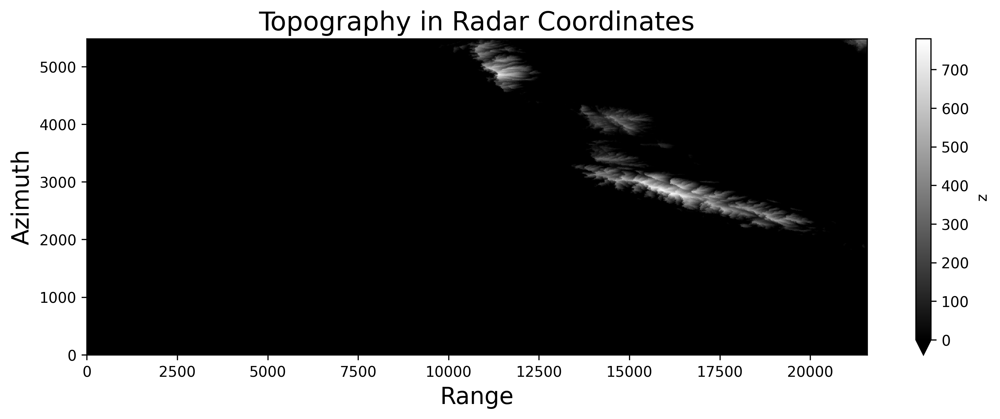

In [23]:
plt.figure(figsize=(12,4), dpi=300)
topo_ra[::4,::4].plot.imshow(cmap='gray', vmin=0)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
plt.title('Topography in Radar Coordinates', fontsize=18)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [24]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plot_opts = {'rasterize': True, 'xlabel':'Range', 'ylabel':'Azimuth', 'width':500, 'height':400}
    plots = topo_ra[::4,::4].hvplot(cmap='gray', title='Topography in Radar Coordinates', **plot_opts)
plots

## Interferograms

Define a single interferogram or a SBAS series. Make direct and reverse interferograms (from past to future or from future to past).

Decimation is useful to save disk space. Geocoding results are always produced on the provided DEM grid so the output grid and resolution are the same to the DEM. By this way, ascending and descending orbit results are always defined on the same grid by design. An internal processing cell is about 30 x 30 meters size and for default output 60m resolution (like to GMTSAR and GAMMA software) decimation 2x2 is reasonable. For the default wavelength=200 for Gaussian filter 1/4 of wavelength is approximately equal to ~60 meters and better resolution is mostly useless (while it can be used for small objects detection). For wavelength=400 meters use 90m DEM resolution with decimation 4x4.

The grids are NetCDF files processing as xarray DataArrays.

In [25]:
pairs = baseline_pairs[['ref_date', 'rep_date']]
pairs

,ref_date,rep_date
0,2015-01-21,2015-03-10
1,2015-01-21,2015-04-03
2,2015-01-21,2015-04-27
3,2015-03-10,2015-04-03
4,2015-03-10,2015-04-27
5,2015-03-10,2015-05-21
6,2015-04-03,2015-04-27
7,2015-04-03,2015-05-21
8,2015-04-27,2015-05-21


In [26]:
# SRTM3 DEM resolution 3 sec, 90 m but use 60 m instead to follow NetCDF chunks size 512x512
decimator = sbas.pixel_decimator(resolution_meters=60, debug=True)

# default parameters: wavelength=200, psize=32, func=None (no postprocessing)
sbas.intf_parallel(pairs, wavelength=400, func=decimator)

DEBUG: average per subswaths ground pixel size in meters: y=14.0, x=16.7
DEBUG: decimator = lambda da: da.coarsen({'y': 4, 'x': 4}, boundary='trim').mean()


Interferograms:   0%|          | 0/9 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

### Load Grids

The grids can be cropped automatically to drop empty areas around valid area (use crop_valid=True). On-the fly geocoding from radar to geographic coordinates is possible by geocode=True.

The grids are NetCDF files in radar coordinates processing as xarray DataArrays.

In [27]:
phasefilts = sbas.open_grids(pairs, 'phasefilt')
phasefilts_ll = sbas.open_grids(pairs, 'phasefilt', geocode=True)

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

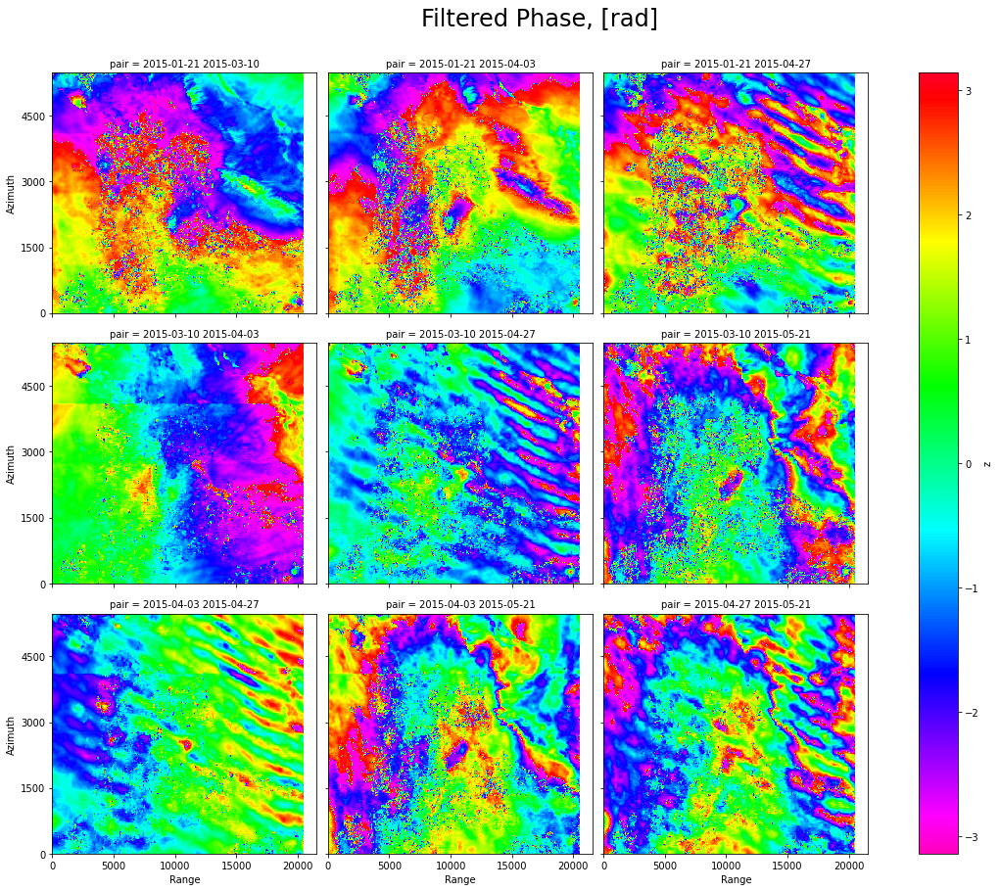

In [28]:
fg = phasefilts.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Filtered Phase, [rad]', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [29]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = phasefilts\
    .hvplot(by='pair', width=320, height=280, subplots=True,
            xlabel='Range', ylabel='Azimuth',
            clim=(-np.pi,np.pi), cmap='gist_rainbow_r')\
    .cols(3).opts(title='Filtered Phase, [rad]')
plots

### Load Grids

The grids can be cropped automatically to drop empty areas around valid area (use crop_valid=True). On-the fly geocoding from radar to geographic coordinates is possible by geocode=True.

The grids are NetCDF files in radar coordinates processing as xarray DataArrays.

In [30]:
corrs = sbas.open_grids(pairs, 'corr')

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

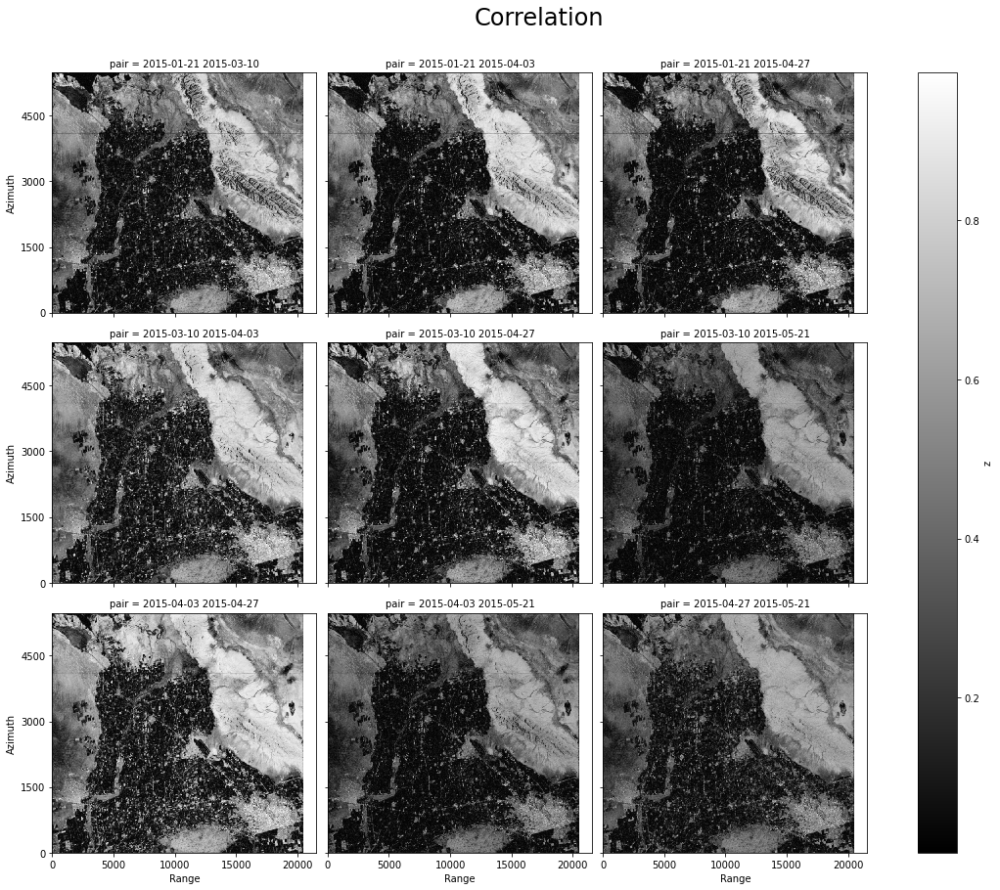

In [31]:
fg = corrs.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    clim=(0, 0.8), cmap='gray'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Correlation', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [32]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = corrs\
    .hvplot(by='pair', width=320, height=280, subplots=True,
            xlabel='Range', ylabel='Azimuth',
            clim=(0, 0.8), cmap='gray')\
    .cols(3).opts(title='Correlation')
plots

## Unwrapping

Unwrapping process requires a lot of RAM and that's really RAM consuming when a lot of parallel proccesses running togeter. To limit the parallel processing tasks apply argument "n_jobs". The default value n_jobs=-1 means all the processor cores van be used. Also, use interferogram decimation above to produce smaller interferograms. And in addition a custom SNAPHU configuration can reduce RAM usage as explained below.

Attention: in case of crash on MacOS Apple Silicon run Jupyter as

`OBJC_DISABLE_INITIALIZE_FORK_SAFETY=YES no_proxy='*' jupyter notebook`

### Unwrapping Post-Processing

Define post-processing function to exclude low-coherence areas and maybe fill them by nearest neighbour interpolation.

### Use individual interferogram correlation values and interpolate gaps later for SBAS analysis

Select the correlation threshold to drop water surfaces and forested areas (usually forming a set of dense areas). Here valid pixels are different between interferograms because these are defined using individual correlation maps. To build valid pixel timeseries for SBAS analysis fill NODATA gaps using nearest interpolation.

In [33]:
CORRLIMIT = 0.075

# fill NODATA gaps for valid pixels only
interpolator = lambda corr, unwrap: sbas.nearest_grid(unwrap).where(corr>=0)

sbas.unwrap_parallel(pairs, threshold=CORRLIMIT, func=interpolator)

Unwrapping:   0%|          | 0/9 [00:00<?, ?it/s]

### Use average stack correlation to define persistent scatters to combine SBAS plus PSI analyses

Select the correlation threshold to define persistent scatterers (usually only sparse pixels). The spare persistent scatters defined equally for all the interferograms and these are ready for SBAS analysis.

In [34]:
#CORRLIMIT = 0.3

# build stack of correlation grids for all the interferometry pairs
#corr_stack = corrs.mean('pair')

# define a post-processing function to crop low-coherence areas
#filter = lambda corr, unwrap: xr.where(corr_stack>=CORRLIMIT, unwrap, np.nan)

#sbas.unwrap_parallel(pairs, func=filter)

### Load Grid

The grids can be cropped automatically to drop empty areas around valid area. Use `open_grids(..., crop_valid=True)` to enable the auto cropping feature. Argument geocode=True means on-the-fly geocoding from radar to geographic coordinates (all the grids saved on disk in radar coordinates plus geocoding matrices are generated for the fast geocoding).

In [35]:
unwraps = sbas.open_grids(pairs, 'unwrap')

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

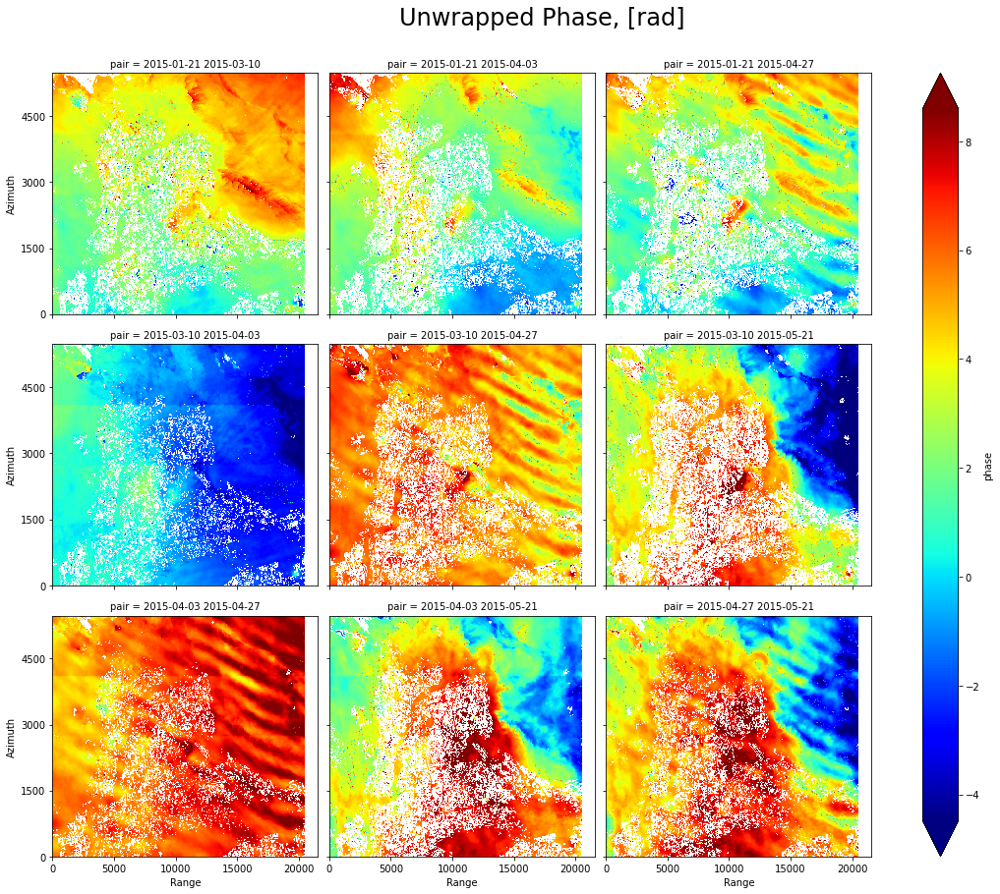

In [36]:
zmin, zmax = np.nanquantile(unwraps, [0.01, 0.99])
fg = unwraps.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Unwrapped Phase, [rad]', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [37]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = unwraps\
    .hvplot(by='pair', width=320, height=280, subplots=True, cmap='turbo',
            xlabel='Range', ylabel='Azimuth',
            clim=tuple(np.nanquantile(unwraps, [0.01, 0.99])))\
    .cols(3).opts(title='Unwrapped Phase, [rad]')
plots

## LOS Displacement

### Load and Calculate Grid

The grids can be post-processed using user-defined function "func". SBAS function `los_displacement_mm()` converts unwrapped phase values to LOS displacement in millimeters.

In [38]:
los_disp_mm = sbas.open_grids(pairs, 'unwrap', func=sbas.los_displacement_mm)

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

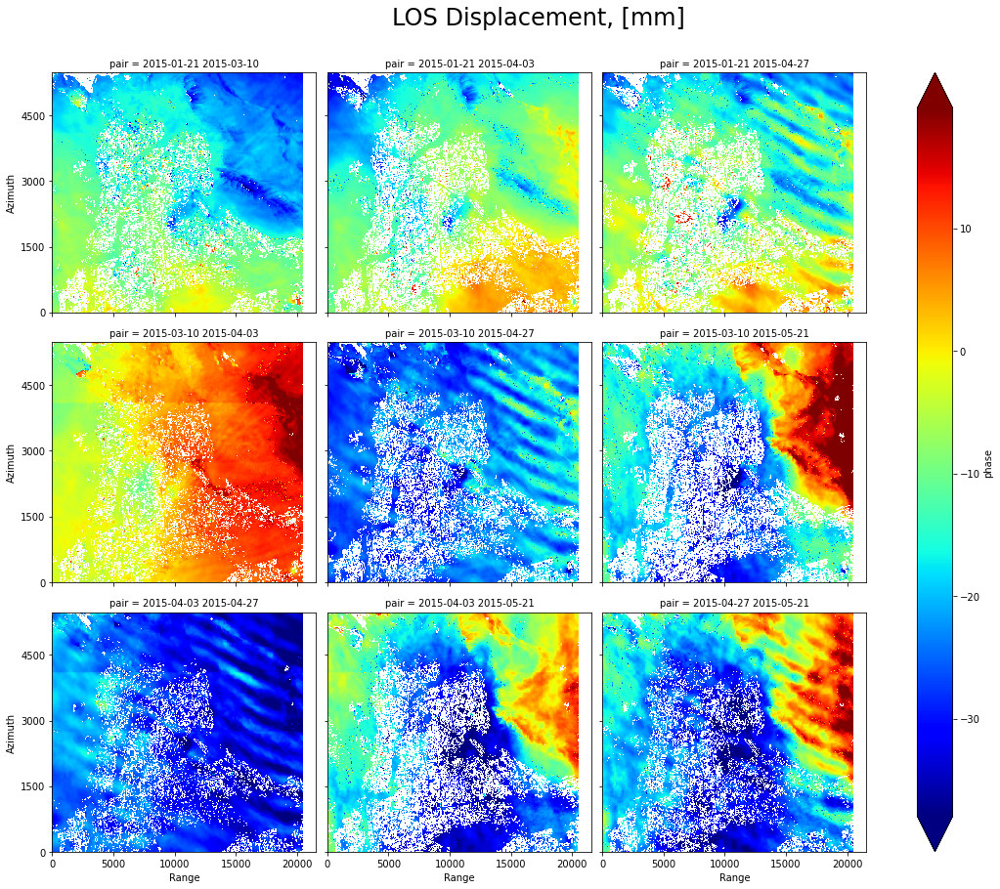

In [39]:
zmin, zmax = np.nanquantile(los_disp_mm, [0.01, 0.99])
fg = los_disp_mm.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [40]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = los_disp_mm\
    .hvplot(by='pair', width=320, height=280, subplots=True, cmap='turbo',
            xlabel='Range', ylabel='Azimuth',
            clim=tuple(np.nanquantile(los_disp_mm, [0.01, 0.99])))\
    .cols(3).opts(title='LOS Displacement, [mm]')
plots

### Geocoding

PyGMTSAR provides a different approach to geocoding - it's a fast matrix operation on a radar-coordinates NetCDF grids stored on disk. By this way, geocoding is very easy and fast - just provide option geocode=True to open the grids.

In [41]:
los_disp_mm_ll = sbas.open_grids(pairs, 'unwrap', geocode=True, func=sbas.los_displacement_mm)

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

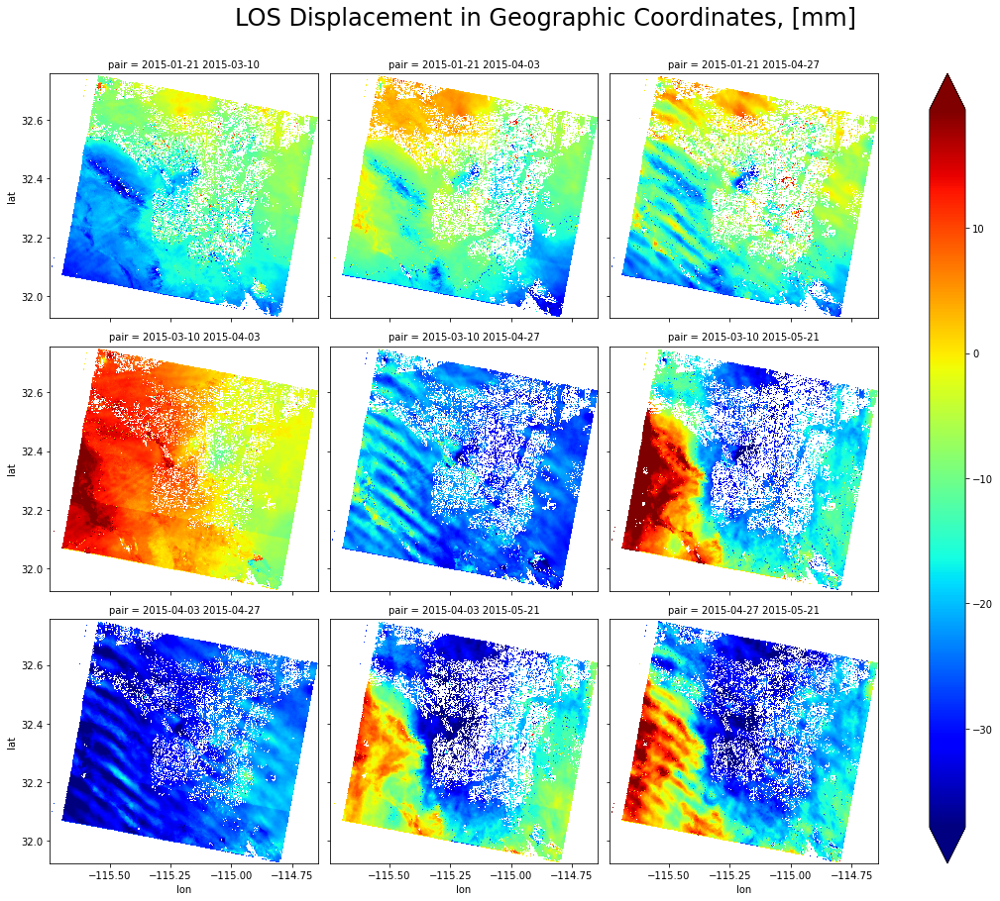

In [42]:
zmin, zmax = np.nanquantile(los_disp_mm_ll, [0.01, 0.99])
fg = los_disp_mm_ll.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('LOS Displacement in Geographic Coordinates, [mm]', y=1.05, fontsize=24)
plt.show()

## GMTSAR SBAS Displacement and Velocity

In [43]:
baseline_pairs

,ref_date,rep_date,ref_timeline,ref_baseline,rep_timeline,rep_baseline
0,2015-01-21,2015-03-10,2015.05,52.61,2015.19,-37.72
1,2015-01-21,2015-04-03,2015.05,52.61,2015.25,-0.00
2,2015-01-21,2015-04-27,2015.05,52.61,2015.32,-30.42
3,2015-03-10,2015-04-03,2015.19,-37.72,2015.25,-0.00
4,2015-03-10,2015-04-27,2015.19,-37.72,2015.32,-30.42
5,2015-03-10,2015-05-21,2015.19,-37.72,2015.38,-50.97
6,2015-04-03,2015-04-27,2015.25,-0.00,2015.32,-30.42
7,2015-04-03,2015-05-21,2015.25,-0.00,2015.38,-50.97
8,2015-04-27,2015-05-21,2015.32,-30.42,2015.38,-50.97


In [44]:
sbas.sbas(baseline_pairs, smooth=1)

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

### Load Displacement Grids with Interpolation and Geocoding

As geocoding the interpolation is too just a option to open the radar-coordinates NetCDF grids.

In [45]:
disps = sbas.open_grids(sbas.df.index, 'disp', func=sbas.nearest_grid, mask=phasefilts.min('pair'), add_subswath=False)
disps_ll = sbas.open_grids(sbas.df.index, 'disp', geocode=True,
                           func=sbas.nearest_grid, mask=phasefilts_ll.min('pair'), add_subswath=False)

Loading:   0%|          | 0/5 [00:00<?, ?it/s]

Loading:   0%|          | 0/5 [00:00<?, ?it/s]

### Static Plots

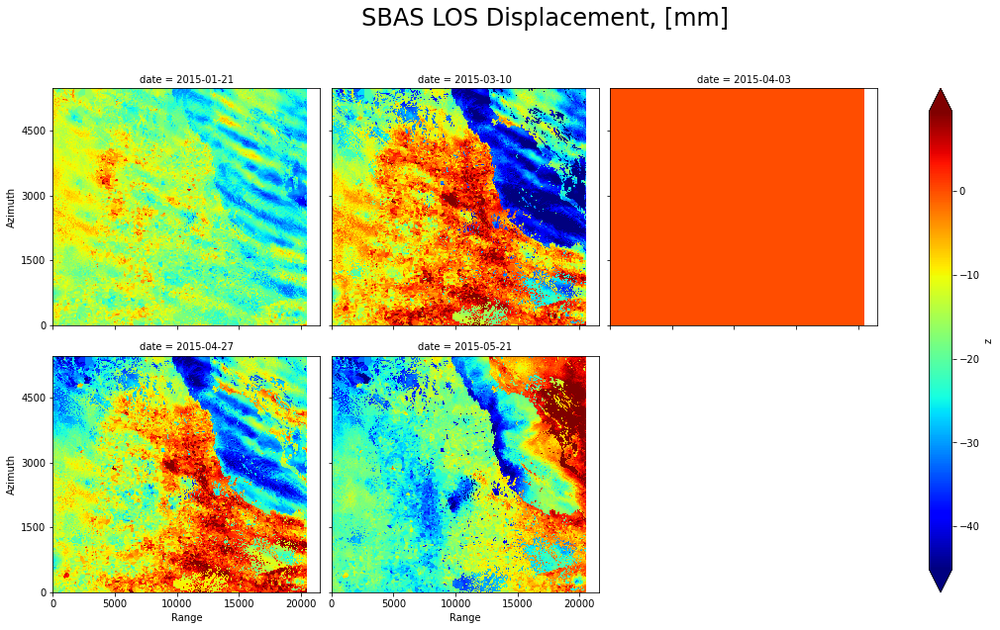

In [46]:
zmin, zmax = np.nanquantile(disps, [0.01, 0.99])
fg = disps.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS LOS Displacement, [mm]', y=1.1, fontsize=24)
plt.show()

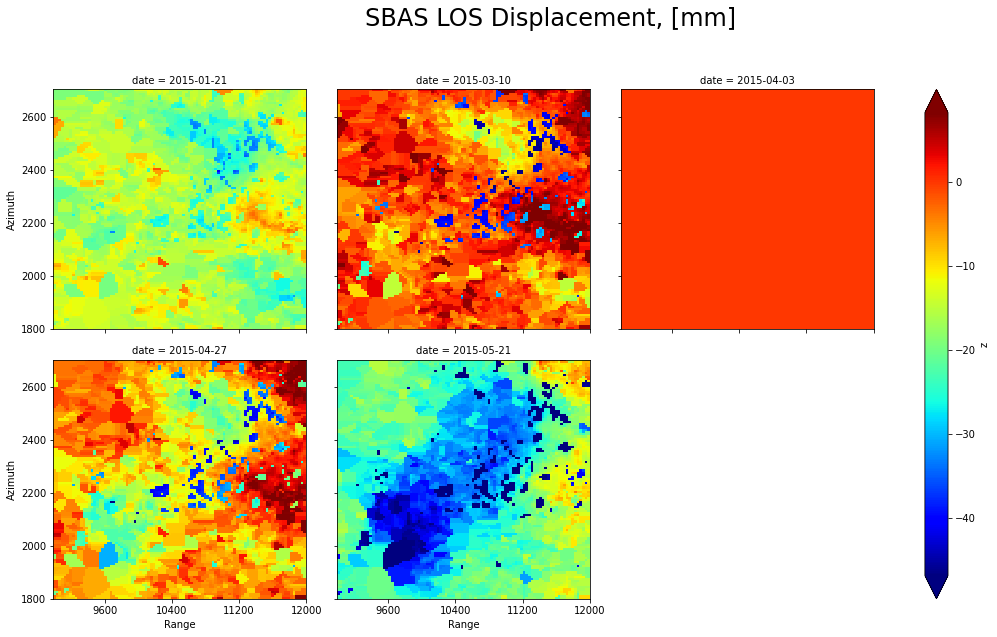

In [47]:
disps_subset = disps.sel(x=slice(9000,12000), y=slice(1800,2700))
zmin, zmax = np.nanquantile(disps_subset, [0.01, 0.99])
fg = disps_subset.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS LOS Displacement, [mm]', y=1.1, fontsize=24)
plt.show()

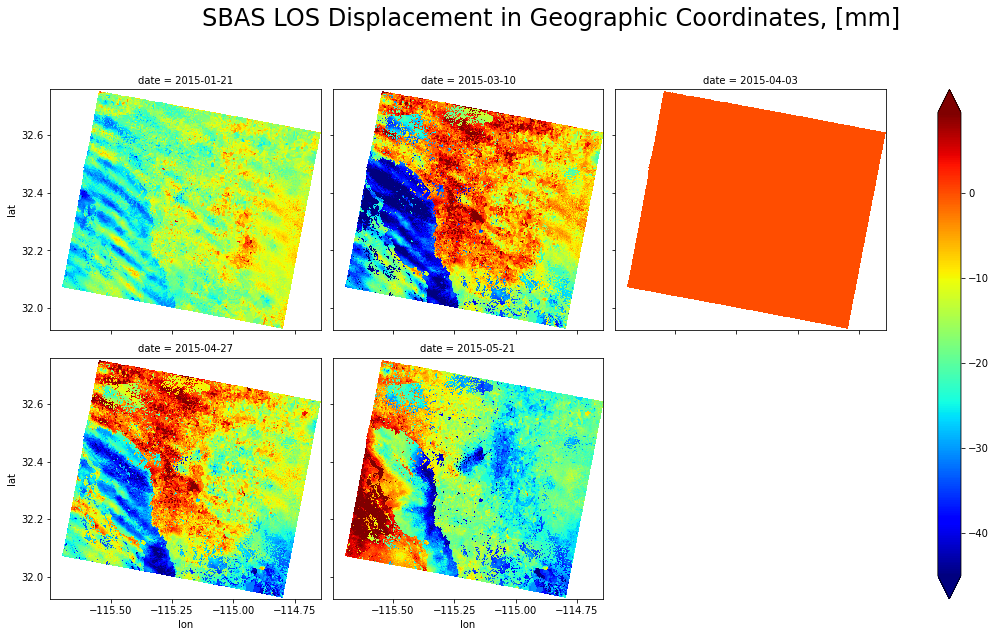

In [48]:
zmin, zmax = np.nanquantile(disps_ll, [0.01, 0.99])
fg = disps_ll.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS LOS Displacement in Geographic Coordinates, [mm]', y=1.1, fontsize=24)
plt.show()

### Load Velocity Grids with Interpolation and Geocoding

SBAS processing is based on GMTSAR function wich doesn't support PyGMTSAR files naming and so use option add_subswath=False to fix it.

In [49]:
vel = sbas.open_grids(None, 'vel', add_subswath=False)
vel_ll = sbas.open_grids(None, 'vel', geocode=True, add_subswath=False)
# interpolate low-coherency areas and mask not valid pixels
vel_filled = sbas.open_grids(None, 'vel', func=sbas.nearest_grid, mask=phasefilts.min('pair'), add_subswath=False)
vel_filled_ll = sbas.open_grids(None, 'vel', geocode=True,
                               func=sbas.nearest_grid, mask=phasefilts_ll.min('pair'), add_subswath=False)

### Static Plots

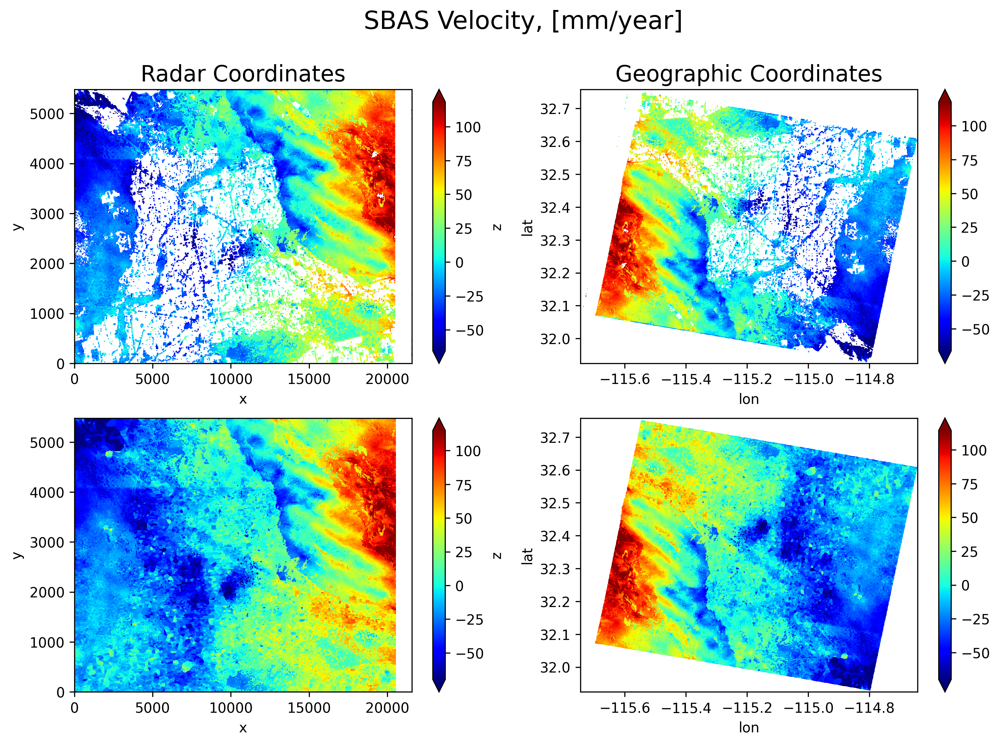

In [50]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(12, 8), dpi=300)
zmin, zmax = np.nanquantile(vel, [0.01, 0.995])
vel.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax1)
zmin, zmax = np.nanquantile(vel_ll, [0.01, 0.995])
vel_ll.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax2)
zmin, zmax = np.nanquantile(vel_filled, [0.01, 0.995])
vel_filled.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax3)
zmin, zmax = np.nanquantile(vel_filled_ll, [0.01, 0.995])
vel_filled_ll.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax4)
ax1.set_title('Radar Coordinates', fontsize=16)
ax2.set_title('Geographic Coordinates', fontsize=16)
plt.suptitle('SBAS Velocity, [mm/year]', fontsize=18)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [51]:
plots = None
if USE_INTERACTIVE_PLOTS:
    zmin, zmax = np.nanquantile(vel_filled_ll, [0, 0.99])
    opts_common = {'x':'lon', 'y':'lat', 'geo':True, 'width':330, 'height':280,
                   'cmap':'turbo', 'colorbar':True, 'clim':(zmin, zmax)}
    opts1 = {'tiles':gstiles, 'alpha':0.4, 'title':'Google Satellite'}
    opts2 = {'tiles':ottiles, 'alpha':0.4, 'title':'OpenTopoMap'}
    opts3 = {'tiles':False,   'alpha':1.4, 'title':'SBAS Velocity'}
    plots = vel_filled_ll.hvplot(**{**opts_common, **opts1}).opts(xrotation=45) + \
    vel_filled_ll.hvplot(**{**opts_common, **opts2}).opts(xrotation=45) + \
    vel_filled_ll.hvplot(**{**opts_common, **opts3}).opts(xrotation=45)
plots

## PyGMTSAR SBAS Displacement

### Detrend Unwrapped Phase

Remove trend and apply gaussian filter to fix ionospheric effects and solid Earh's tides. Fill empty areas using nearest interpolation.

In [52]:
sbas.detrend_parallel(pairs, wavelength=12000)

Detrending:   0%|          | 0/9 [00:00<?, ?it/s]

### Load Detrended Unwrapped Phase Grids

In [53]:
unwraps_detrend = sbas.open_grids(pairs, 'detrend')

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

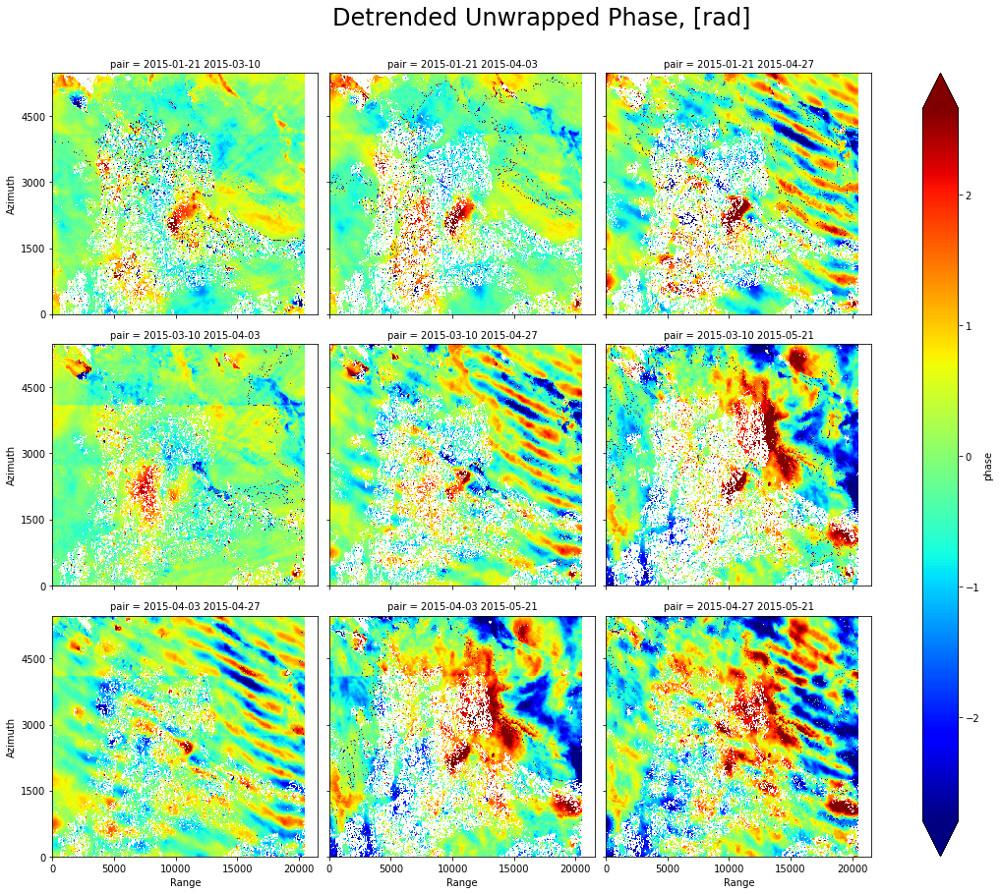

In [54]:
zmin, zmax = np.nanquantile(unwraps_detrend, [0.01, 0.99])
fg = unwraps_detrend.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Detrended Unwrapped Phase, [rad]', y=1.05, fontsize=24)
plt.show()

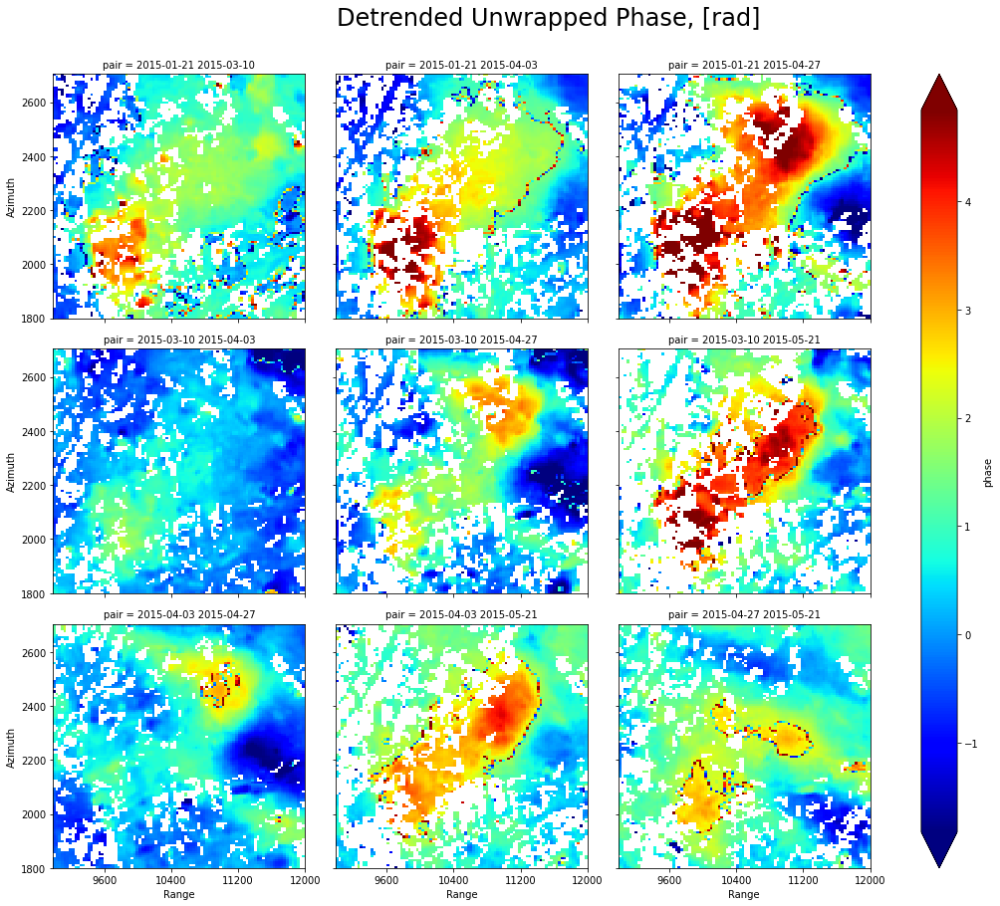

In [55]:
unwraps_detrend_subset = unwraps_detrend.sel(x=slice(9000,12000), y=slice(1800,2700))

zmin, zmax = np.nanquantile(unwraps_detrend_subset, [0.01, 0.99])
fg = unwraps_detrend_subset.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Detrended Unwrapped Phase, [rad]', y=1.05, fontsize=24)
plt.show()

### Calculate Displacement Using Coherence-Weighted Least-Squares Solution

In [56]:
# process the full unwrap grid (correlation grid will be cropped if needed)
sbas.sbas_parallel(pairs)

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

Computing:   0%|          | 0/4 [00:00<?, ?it/s]

Saving:   0%|          | 0/5 [00:00<?, ?it/s]

In [57]:
# use sorted dates to open all the grids
dates = np.unique(pairs.values.flatten() if isinstance(pairs, pd.DataFrame) else pairs.flatten())

### Load SBAS Results and Calculate LOS Displacement

In [58]:
# interpolate for valid coherence area only
valid_area = corrs.min('pair')
def interp(da):
    return sbas.nearest_grid(da).where(~np.isnan(valid_area))

# use wrapper "interp"  instead of "sbas.nearest_grid" for post-processing functions list below
disps = sbas.open_grids(dates, 'disp', func=[sbas.los_displacement_mm, interp])

Loading:   0%|          | 0/5 [00:00<?, ?it/s]

In [59]:
# prepare the results for better visualization
# filter outliers
#disps = disps.where(abs(disps)<1e3)
# clean 1st zero-filled displacement map for better visualization
disps[0] = np.nan
# calculate cumulative displacement like to GMTSAR SBAS
disps_cum = disps.cumsum('date')
# clean 1st zero-filled displacement map for better visualization
disps_cum[0] = np.nan

### Static Plots

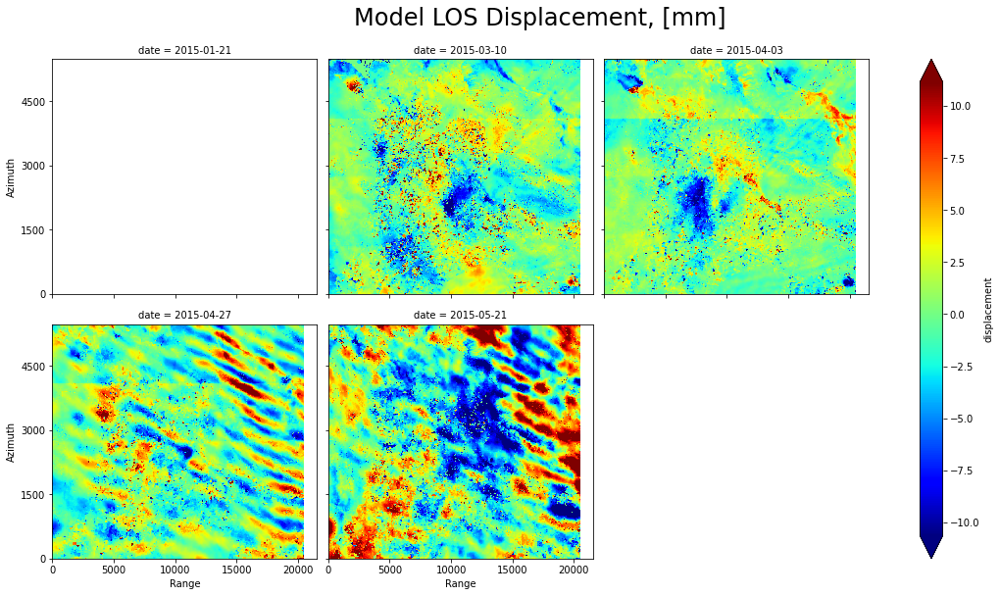

In [60]:
zmin, zmax = np.nanquantile(disps, [0.01, 0.99])
fg = disps.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Model LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

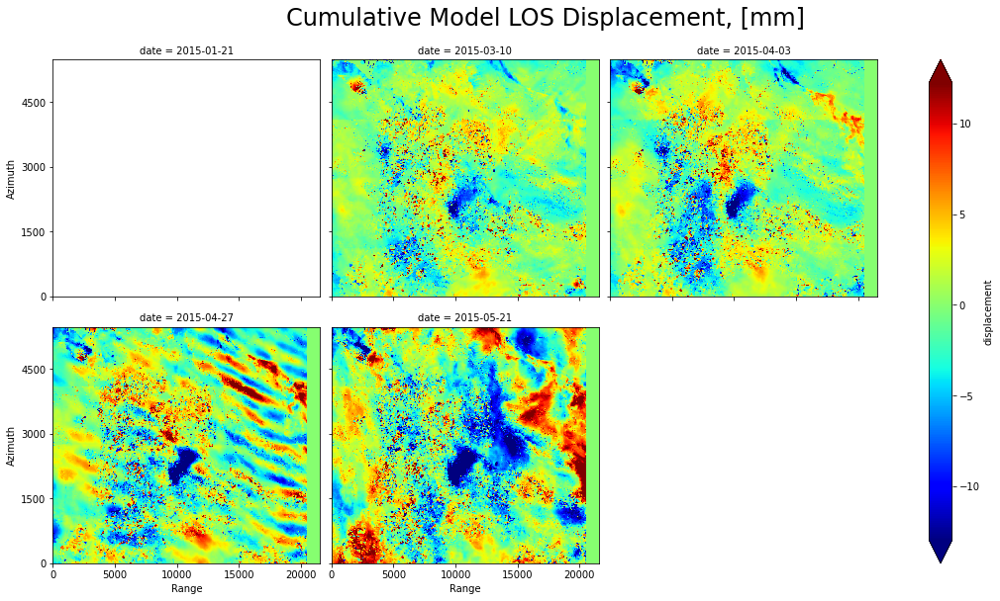

In [61]:
zmin, zmax = np.nanquantile(disps_cum, [0.01, 0.99])
fg = disps_cum.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Cumulative Model LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

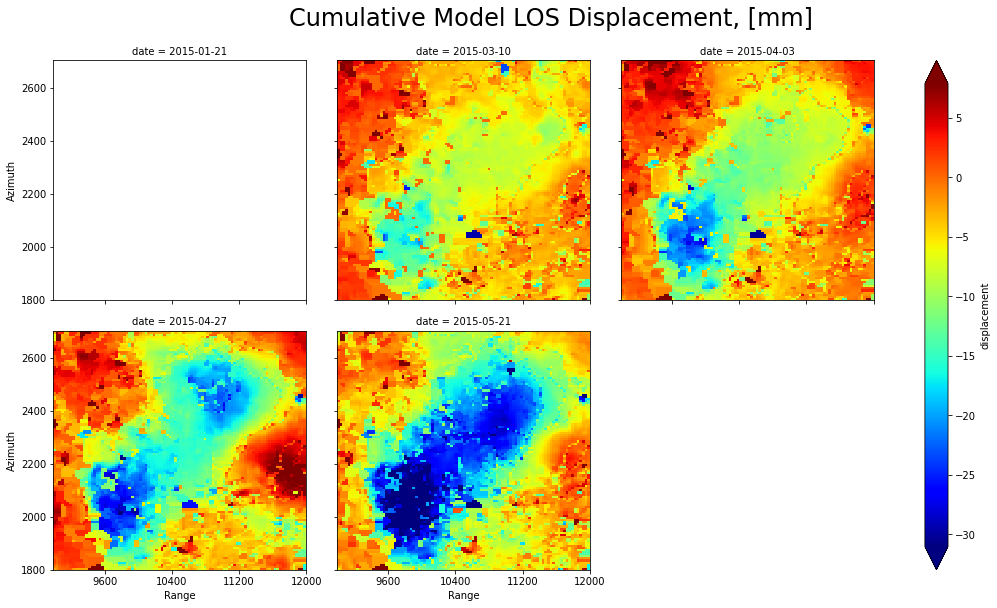

In [62]:
disps_cum_subset = disps_cum.sel(x=slice(9000,12000), y=slice(1800,2700))

zmin, zmax = np.nanquantile(disps_cum_subset, [0.01, 0.99])
fg = disps_cum_subset.plot.imshow(
    col='date',
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Cumulative Model LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

Geocoding:   0%|          | 0/5 [00:00<?, ?it/s]

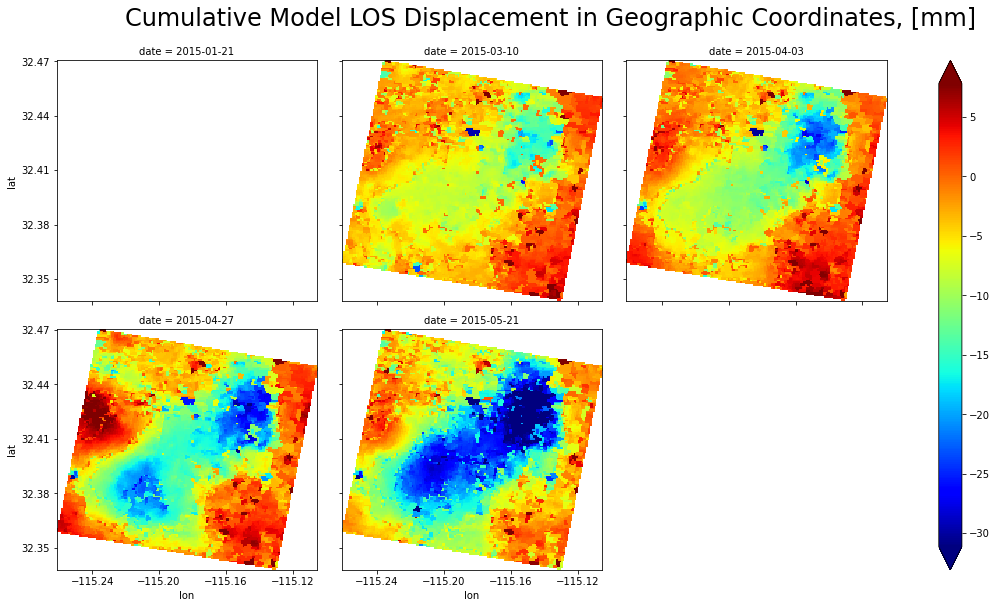

In [63]:
# geocode the subsets on the full interferogram grid and crop a valid area only
disps_cum_subset_ll = sbas.cropna(sbas.intf_ra2ll(disps_cum.sel(x=slice(9000,12000), y=slice(1800,2700))))

zmin, zmax = np.nanquantile(disps_cum_subset_ll, [0.01, 0.99])
fg = disps_cum_subset_ll.plot.imshow(
    col='date',
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Cumulative Model LOS Displacement in Geographic Coordinates, [mm]', y=1.05, fontsize=24)
plt.show()

## Conclusion

For now you have the full control on interferometry processing and unwrapping and able to run it everywhere: on free of charge Google Colab instances, on local MacOS and Linux computers and on Amazon EC2 and Google Cloud VM and AI Notebook instances.
    
The original GMTSAR example processing is enhanced by additional post-processing and SBAS result is better now.